# FEATURE REPRESENTATION AND SCENE STITCHING

## Part 1: Stitch Images Together to Create a Panoramic View

The goal of this project is to combine five horizontally overlapping photographs into a single panoramic image. Images must be supplied in left-to-right order.

In [11]:
import os
import cv2
import copy
import itertools
import numpy as np
import time
from itertools import chain
import math
import matplotlib.pyplot as plt

In [12]:
plt.rcParams['figure.figsize'] = [40, 10] # figure size in inches

def draw_images(imgs):
    if len(imgs) > 1:
        fig, axs = plt.subplots(1, len(imgs))
        for idx, img in enumerate(imgs):
            axs[idx].axis("off")
            axs[idx].imshow(img)
    else:
        fig, ax = plt.subplots()
        ax.axis("off")
        ax.imshow(imgs[0])
    plt.show()

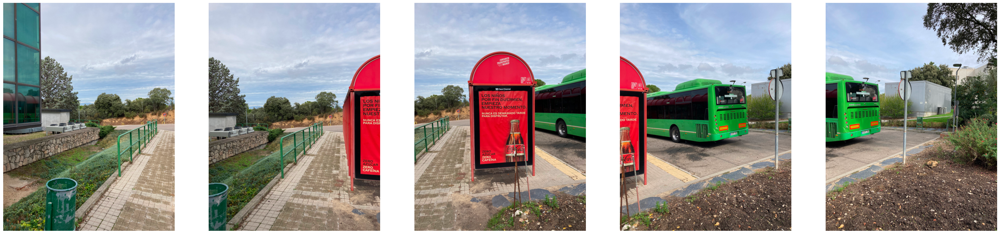

In [13]:
filenames = ["images/1.png", "images/2.png", "images/3.png", "images/4.png", "images/5.png"]
imgs=[]

for file in filenames:
    img = cv2.imread(file)
    img = cv2.cvtColor(img ,cv2.COLOR_BGR2RGB) # convert to RGB
    imgs.append(img)
    
# Draw images
draw_images(imgs)

Now, to stich all the images and form a panoramic, we will create different functions. In essence, this functions automate the previous steps followed: from keypoints and descriptors extraction to estimation of the homograhy between each pair of adjacent images. Moreover, we have created another functions to perform the stiching process and to blend properly each pair of adjacent images:

In [14]:
def SIFT_Detector(img1, img2):
    """
    Function that returns the SIFT parameters of an image.
    """
    sift = cv2.SIFT_create()
    keypoints1, descriptors1 = sift.detectAndCompute(img1, None)
    keypoints2, descriptors2 = sift.detectAndCompute(img2, None)
    return keypoints1, descriptors1, keypoints2, descriptors2


def BF_KNN_Matcher(descriptors1, descriptors2):
    """
    Function that returns the matches (brutal force matcher with knn matching strategy) between 2 images based on their descriptors.
    """
    bf = cv2.BFMatcher(cv2.NORM_L2)
    matches = bf.knnMatch(descriptors1, descriptors2, k=2)
    return matches


def RANSAC_Homography(img2, img1, r):
    """
    Function that obtains the homography between two images using RANSAC Algorithm.
    """
    # Adjusting the image's characteristics
    img1 =cv2.cvtColor(img1, cv2.COLOR_RGB2GRAY)
    img2 =cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)
    img1 = scaleImages(img1,r)
    img2 = scaleImages(img2,r)
    
    # Obteining their keypoints, descriptors and matches
    keypoints_SIFT_1, descriptors1, keypoints_SIFT_2, descriptors2 = SIFT_Detector(img1, img2)
    matches_bf_knn = BF_KNN_Matcher(descriptors1, descriptors2)
    
    # Applying Ratio Test
    good = [m for m,n in matches_bf_knn if m.distance < 0.8*n.distance]
    
    # To create an homography we need at least 4 points
    if len(good) >= 4:
        src_pts = np.float32([keypoints_SIFT_1[m.queryIdx].pt for m in good])
        dst_pts = np.float32([keypoints_SIFT_2[m.trainIdx].pt for m in good])
        for i in src_pts:
            i[0]=i[0]/r
            i[1]=i[1]/r
        for i in dst_pts:
            i[0]=i[0]/r
            i[1]=i[1]/r
            
    # Obtain the homography using RANSAC
        (H, mask) = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    return H


def scaleImages(images, r):
    """
    Function that scales an image using an specific ratio.
    """
    width = int(images.shape[1] * r)
    height = int(images.shape[0] * r)
    dim = (width, height)
    resized = cv2.resize(images, dim, interpolation = cv2.INTER_AREA)
    return resized


def WarpTwoImages(img1, img0, H=None, r=0.2):
    """
    Function that warps two images, obtains the homography if necessary 
    and deletes any black borders between warppings.
    """
    # If an homography is not passed we calculate it.
    # It also means that there will be no black borders, so we don't need to delete them.
    clean_borders = False
    if H is None:
        clean_borders = True
        H = RANSAC_Homography(img1, img0, r)
        
    # Obtain the dimensions of both images.
    h0, w0 = img0.shape[:2]
    h1, w1 = img1.shape[:2]
    
    # Obtain the corners of each image.
    pts0 = np.float32([[0, 0], [0, h0], [w0, h0], [w0, 0]]).reshape(-1, 1, 2)
    pts1 = np.float32([[0, 0], [0, h1], [w1, h1], [w1, 0]]).reshape(-1, 1, 2)
    
    # Transform the corners of one of the images, according to the homography.
    pts0_ = cv2.perspectiveTransform(pts0, H)
    
    # Calculate the maximum and minimum dimensions.
    pts = np.concatenate((pts0_, pts1), axis=0)
    [xmin, ymin] = np.int32(pts.min(axis=0).ravel() - 0.5)
    [xmax, ymax] = np.int32(pts.max(axis=0).ravel() + 0.5)
    
    # Calculate the transformation matrix.
    t = [-xmin, -ymin]
    Ht = np.array([[1, 0, t[0]], [0, 1, t[1]], [0, 0, 1]])
    
    # Warp both images.
    result = cv2.warpPerspective(img0, Ht.dot(H), (xmax-xmin, ymax-ymin))
    
    # If border cleaning is necessary:
    if clean_borders:
        result2 = result.copy()
        result2[t[1]:h1+t[1], t[0]:w1+t[0]] = img1
        
        # We give value to those pixels that are not supposed to be black (borders)
        black_pixels = (result2[t[1]:h1+t[1], t[0]:w1+t[0]] == [0, 0, 0]).all(axis=2)
        non_black_pixels = (result[t[1]:h1+t[1], t[0]:w1+t[0]] != [0, 0, 0]).all(axis=2)
        common_coordinates = np.where(black_pixels & non_black_pixels)
        result2[t[1]:h1+t[1], t[0]:w1+t[0]][common_coordinates] = result[t[1]:h1+t[1], t[0]:w1+t[0]][common_coordinates]
        result = result2
        
    # If it's not necessary, we just "stich" both images.
    else:
        result[t[1]:h1+t[1], t[0]:w1+t[0]] = img1
    return result

Using the functions created we will now join them to make the panoramic view. 

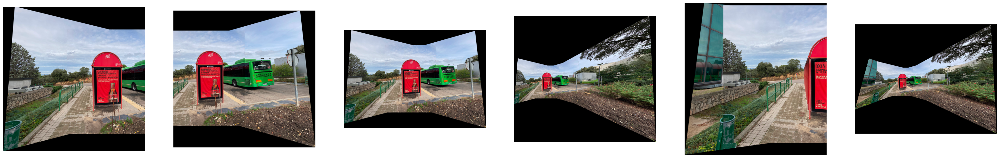

In [15]:
# First we stich images 1-2 and images 2-3, as image 2 will be the one we'll use as reference.
result_12  = WarpTwoImages(imgs[2], imgs[1])
result_23  = WarpTwoImages(imgs[2], imgs[3])

# Then, we stich both projections.
result_123  = WarpTwoImages(result_23, result_12)

# Secondly, we stich image 4 to the mosaic.
result_1234 = WarpTwoImages(result_123, imgs[4])

# Then we stich the first and second images, 0-1.
result_01  = WarpTwoImages(imgs[1], imgs[0])

# And, finally, we stich it to complete the mosaic.
result_01234 = WarpTwoImages(result_1234, result_01)

# We visualize the process.
draw_images([result_12, result_23, result_123, result_1234, result_01, result_01234])

The final result is:

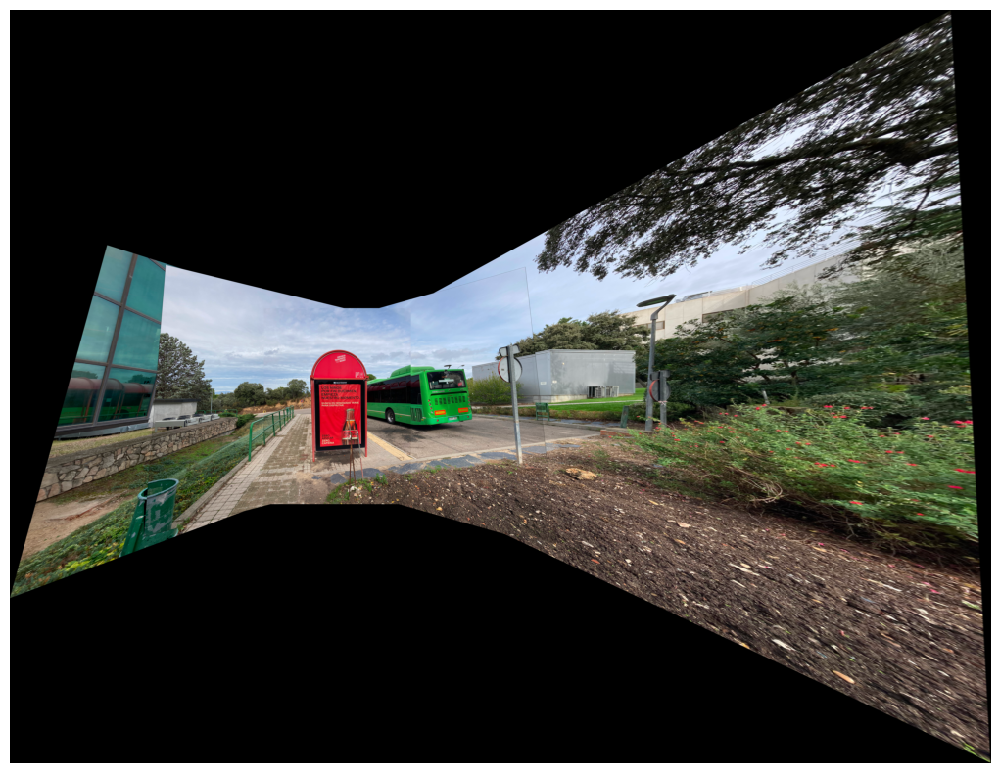

In [16]:
draw_images([result_01234])

## Part 2: Warp 7 Images Over a New Projection to Create a Wide Panorama

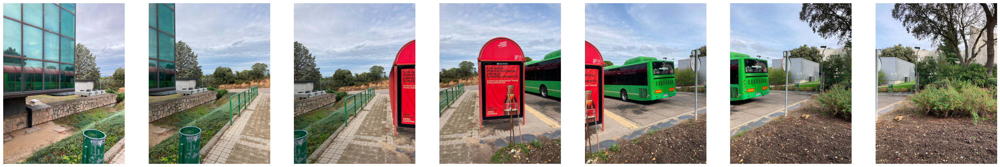

In [17]:
filenames = ["images/0.png", "images/1.png", "images/2.png", "images/3.png", "images/4.png", "images/5.png", "images/6.png"]
imgs=[]
for file in filenames:
    img = cv2.imread(file)
    img = cv2.cvtColor(img ,cv2.COLOR_BGR2RGB) # convert to RGB
    imgs.append(img)
# Draw images
draw_images(imgs)

To begin with, as suggested, we will project the images in a cylindrical surface. Therefore we will create and use a function that trasnforms our images to cylindrical perspective to watch its result. 

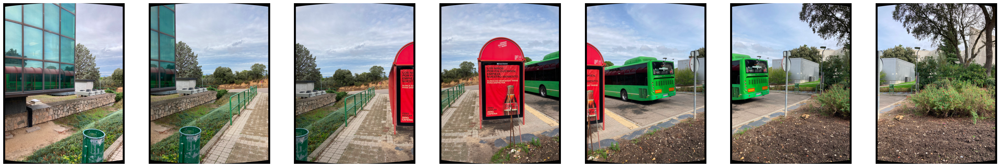

In [18]:
def cylinder_image(img, fov=60):
    height = img.shape[0]
    width = img.shape[1]
    focal_len = width/(2*math.tan(fov))
    K = np.array([[focal_len ,0, width/2], [0, focal_len, height/2], [0, 0, 1]])
    foc_len = (K[0][0] + K[1][1])/2
    cylinder = np.zeros_like(img)
    temp = np.mgrid[0:img.shape[1],0:img.shape[0]]
    x,y = temp[0],temp[1]
    theta= (x- K[0][2])/foc_len 
    h = (y-K[1][2])/foc_len 
    p = np.array([np.sin(theta),h,np.cos(theta)])
    p = p.T
    p = p.reshape(-1,3)
    image_points = K.dot(p.T).T
    points = image_points[:,:-1]/image_points[:,[-1]]
    points = points.reshape(img.shape[0],img.shape[1],-1)
    cylinder = cv2.remap(img, (points[:, :, 0]).astype(np.float32), (points[:, :, 1]).astype(np.float32), cv2.INTER_LINEAR)
    return cylinder

cylinder_images=[]
for img in imgs:
    cylinder_images.append(cylinder_image(img))
draw_images(cylinder_images)

Now, to form the panoramic image, we will use some of the functions implemented in the previous exercise, slightly changed to adapt the result to the cylindrical perspective.

In [19]:
def SIFT_Detector(img1, img2):
    """
    Function that returns the SIFT parameters of an image.
    """
    sift = cv2.SIFT_create()
    keypoints1, descriptors1 = sift.detectAndCompute(img1, None)
    keypoints2, descriptors2 = sift.detectAndCompute(img2, None)
    return keypoints1, descriptors1, keypoints2, descriptors2

def BF_KNN_Matcher(descriptors1, descriptors2):
    """
    Function that returns the matches between 2 images based on their descriptors.
    """
    bf = cv2.BFMatcher(crossCheck=False)
    matches = bf.knnMatch(descriptors1, descriptors2, k=2)
    return matches

def RANSAC_Homography_Cylinder(img1, img2, r=0.2):
    """
    Function that obtains the homography between two images using RANSAC Algorithm.
    """
    # Adjusting the image's characteristics
    img1 =cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
    img2 =cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

    # Obteining their keypoints, descriptors and matches
    keypoints_SIFT_1, descriptors1, keypoints_SIFT_2, descriptors2 = SIFT_Detector(img1, img2)
    matches_bf_knn = BF_KNN_Matcher(descriptors1, descriptors2)

    # Applying Ratio Test
    good = [m for m,n in matches_bf_knn if m.distance < 0.75*n.distance]
    # Taking best 25 matches
    good = sorted(good, key = lambda x:x.distance)
    good = good[:25]
    src_pts = np.float32([keypoints_SIFT_1[m.queryIdx].pt for m in good]).reshape((-1, 1, 2))
    dst_pts = np.float32([keypoints_SIFT_2[m.trainIdx].pt for m in good]).reshape((-1, 1, 2))

    # Obtain the homography using RANSAC
    (H, mask) = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC)
    return H

def stich_images(result, img2, t, h1, w1):
    """
    Function that joins and deletes any black borders between warppings.
    """
    result2 = result.copy()
    result2[t[1]:h1+t[1], t[0]:w1+t[0]] = img2
    black_pixels = (result2[t[1]:h1+t[1], t[0]:w1+t[0]] == [0, 0, 0]).all(axis=2)
    non_black_pixels = (result[t[1]:h1+t[1], t[0]:w1+t[0]] != [0, 0, 0]).all(axis=2)
    common_coordinates = np.where(black_pixels & non_black_pixels)
    result2[t[1]:h1+t[1], t[0]:w1+t[0]][common_coordinates] = result[t[1]:h1+t[1], t[0]:w1+t[0]][common_coordinates]
    return result2

def WarpTwoCyliders(img1, img2):
    """
    Function that warps two cilindrical images, obtains the homography and 
    deletes any black borders between warppings.
    """
    img1 = cylinder_image(img1)
    img2 = cylinder_image(img2)

    # Obtain the homography between images.
    H = RANSAC_Homography_Cylinder(img1, img2)
    # Obtain the dimensions of both images.
    h0, w0 = img1.shape[:2]
    h1, w1 = img2.shape[:2]

    # Obtain the corners of each image.
    pts0 = np.float32([[0, 0], [0, h0], [w0, h0], [w0, 0]]).reshape(-1, 1, 2)
    pts1 = np.float32([[0, 0], [0, h1], [w1, h1], [w1, 0]]).reshape(-1, 1, 2)
    # Transform the corners of one of the images, according to the homography.
    pts0_ = cv2.perspectiveTransform(pts0, H)
    # Calculate the maximum and minimum dimensions.
    pts = np.concatenate((pts0_, pts1), axis=0)
    [xmin, ymin] = np.int32(pts.min(axis=0).ravel() - 0.5)
    [xmax, ymax] = np.int32(pts.max(axis=0).ravel() + 0.5)

    # Calculate the transformation matrix.
    t = [-xmin, -ymin]
    Ht = np.array([[1, 0, t[0]], [0, 1, t[1]], [0, 0, 1]])

    # Warp both images.
    result = cv2.warpPerspective(img1, Ht.dot(H), (xmax-xmin, ymax-ymin))
    
    # Clean black borders between images. 
    result = stich_images(result, img2, t, h1, w1)
    return result

Now we continue on to stich the images between them:

In [20]:
# First, we join images 2, 3 and 4.
result_34 = WarpTwoCyliders(imgs[4], imgs[3])
result_234 = WarpTwoCyliders(imgs[2], result_34)
# Average running time: 15s

In [21]:
# Then, images 4, 5 and 6. 
result_45 = WarpTwoCyliders(imgs[4], imgs[5])
result_456 = WarpTwoCyliders(imgs[6], result_45)
# Average running time: 35s

In [22]:
# We, now, join images 2, 3, 4, 5 and 6
result_23456 = WarpTwoCyliders(result_456, result_234)
# Average running time: 40s

In [23]:
# We, now, join images 0 and 1
result_01 = WarpTwoCyliders(imgs[0], imgs[1])
# Average running time: 5s

In [24]:
# And finally warping images 0 and 1 with the complete mosaic
result_0123456 = WarpTwoCyliders(result_23456, result_01)
# Average running time: 30s

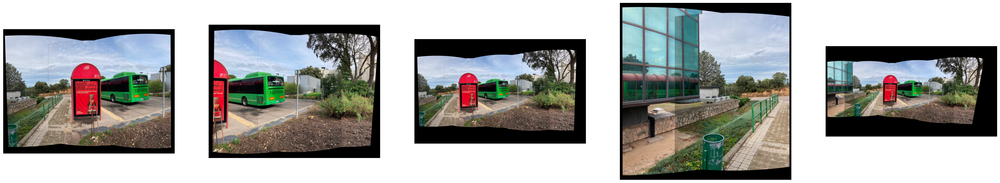

In [25]:
# We visualize the process
draw_images([result_234, result_456, result_23456, result_01, result_0123456])

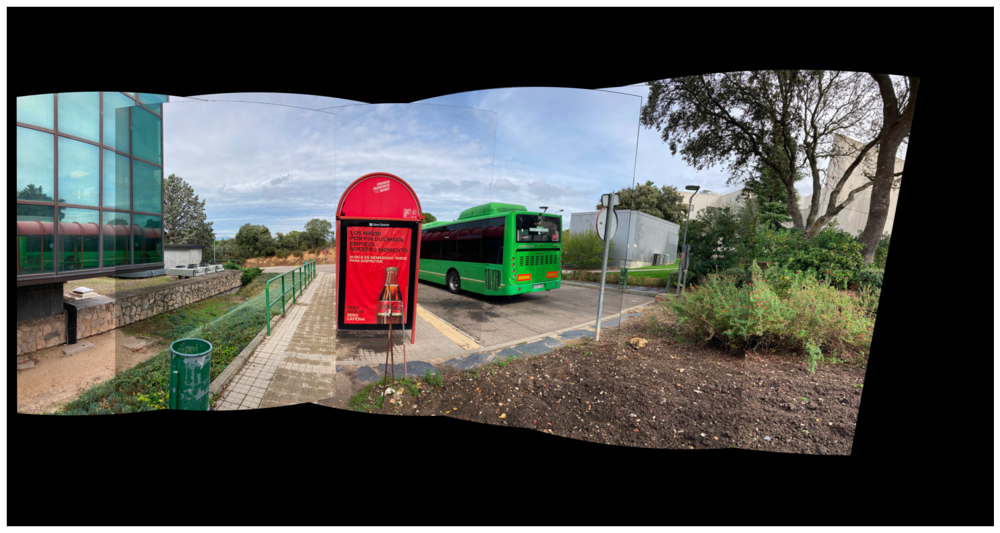

In [26]:
# And the final result
draw_images([result_0123456])

Finally, we do some cropping in our final panorama image: 

In [27]:
# Parameters for cropping based on the position of the final image
y=350
x=0
h=2600
w=5950
crop_img = result_0123456[y:y+h, x:x+w]
pano_def = crop_img

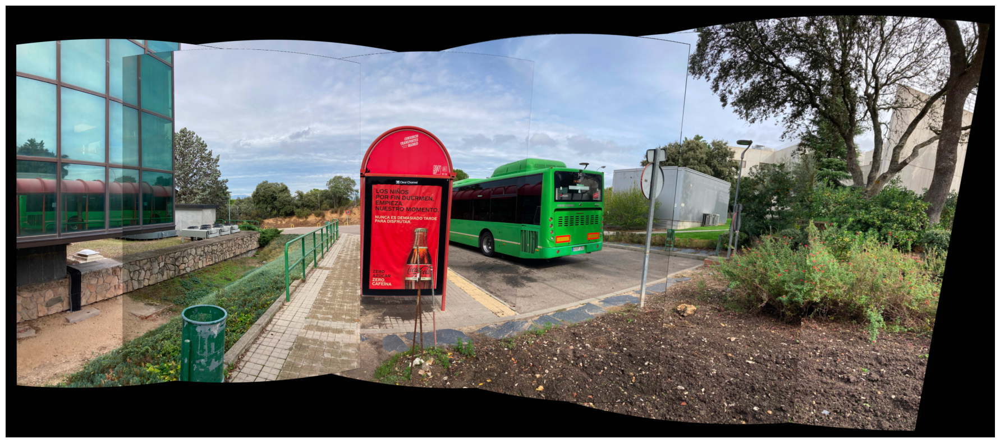

In [28]:
draw_images([pano_def])